<a href="https://colab.research.google.com/github/LiHuaqing-tum/Safe-Flow-Matching/blob/safe-flow-matching-pipeline/code%20designed%20for%20colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:

!pip install cvxpy ecos
import cvxpy as cp
import torch
from torch.utils.data import Dataset, DataLoader
import numpy as np

class SafeFlowDataset(Dataset):
    def __init__(self, npz_path, device="cpu"):
        super().__init__()
        self.device = device
        self.raw = np.load(npz_path, allow_pickle=True)["data"]
        self.samples = list(self.raw)

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        sample = self.samples[idx]
        #数据转化
        start = torch.tensor(sample["start"], dtype=torch.float32)
        goal = torch.tensor(sample["goal"], dtype=torch.float32)
        obstacles = torch.tensor(sample["obstacles"], dtype=torch.float32).flatten()  # [9]
        trajectory = torch.tensor(sample["trajectory"], dtype=torch.float32)  # [H, 2]#数据集中的H大小反映平滑度
        #数据转化
        time_steps = torch.linspace(0, 1, steps=trajectory.shape[0]).unsqueeze(-1)   # [H, 1]
        inputs = torch.cat([time_steps, trajectory], dim=-1)  # [H, 3]

        return inputs, goal, obstacles, trajectory

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 220.1/220.1 kB 16.1 MB/s eta 0:00:00


In [2]:
import torch
import torch.nn as nn

class SafeFlowNet(nn.Module):
    def __init__(self, hidden_dim=128):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(12, hidden_dim),  # 输入: t,x,y和3个圆形障碍物的9个参数（x,y,r）
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, 2)    # 输出速度: dx, dy
        )

    def forward(self, t_x, obstacles):
        B, H, _ = t_x.shape
        obs = obstacles.unsqueeze(1).repeat(1, H, 1)  # 从[B,9]到][B, H, 9]
        inp = torch.cat([t_x, obs], dim=-1)  # [B, H, 12]，把t,x,y和obs拼起来
        return self.net(inp)#最后通过inp算出速度

In [4]:
import numpy as np
import torch
#可视化
def rollout_trajectory(model, start, obstacles, steps=10, dt=1.0/10):

    device = start.device
    B = start.shape[0]
    x = start
    trajectory = [x]#trajectory起点是start

    for i in range(steps):
        t = torch.full((B, 1), i * dt, dtype=torch.float32, device=device) #所有元素都是i*dt,[B, 1]
        tx = torch.cat([t, x], dim=-1).unsqueeze(1)  # [B, 1, 3]
        v = model(tx, obstacles).squeeze(1)#预测速度
        x = x + dt * v
        trajectory.append(x)#把当前算的trajectory加入其中

    return torch.stack(trajectory, dim=1)#返回轨迹，增加维度拼成大tensor


In [68]:
import cvxpy as cp
import numpy as np

# 计算障碍函数 h(x) 及其梯度 ，针对圆形障碍
def compute_barrier_terms(x, obstacles, phi=10.0):#pi是屏蔽函数的强度因子
    grads = []
    hs = []
    for (cx, cy, r) in obstacles:
        c = np.array([cx, cy])
        h_val = np.sum((x - c)**2) - r**2
        grad_h = 2 * (x - c)
        hs.append(h_val)
        grads.append(grad_h)
    return grads, hs

# 解 QP 最小化 u，确保 FMBF 约束成立
def solve_ut_qp(x, v, obstacles, t, t_final, alpha=1.0, eps=1e-6):

    u = cp.Variable(2)
    objective = cp.Minimize(cp.sum_squares(u))
    constraints = []

    grads, hs = compute_barrier_terms(x, obstacles)
    for grad_h, h_val in zip(grads, hs):
        if h_val < 0:
            phi = 5.0
        else:
            phi = 5.0 + alpha / (t_final - t + eps)

        constraint = grad_h @ (v + u) + phi * h_val >= 0
        constraints.append(constraint)

    prob = cp.Problem(objective, constraints)
    prob.solve(solver=cp.ECOS)

    if u.value is not None:
        return u.value.astype(np.float32)
    else:
        return np.zeros(2, dtype=np.float32)


In [69]:
import numpy as np

# 安全 rollout 函数：每一步都加上 solve_ut_qp 返回的控制修正项 u_t
def rollout_trajectory_safe(model, start, obstacles, steps=10, dt=1.0/10, phi=10.0):
    device = start.device
    B = start.shape[0] # Assuming batch size is 1 for visualization
    if B != 1:
        print("Warning: rollout_trajectory_safe designed for batch size 1 in visualization.")

    x = start.clone() # Start position [1, 2]
    trajectory = [x.squeeze(0).cpu()]
    obstacles_np = obstacles.squeeze(0).cpu().numpy().reshape(-1, 3) # [9] -> [3, 3]
    obstacles_list = [tuple(obs) for obs in obstacles_np] # [(cx, cy, r), ...]

    model.eval()

    for i in range(steps):
        t = torch.full((B, 1), i * dt, dtype=torch.float32, device=device)
        tx = torch.cat([t, x], dim=-1).unsqueeze(1)  # [B, 1, 3]

        with torch.no_grad():
            v = model(tx, obstacles).squeeze(1)      # [B, 2]


        x_np = x.squeeze(0).cpu().numpy() # [2]

        v_np = v.squeeze(0).cpu().numpy() # [2]

        u_t_np = solve_ut_qp(x_np, v_np, obstacles_list, phi) # [2]


        u_t = torch.tensor(u_t_np, dtype=torch.float32, device=device).unsqueeze(0) # [1, 2]


        v_safe = v + u_t # [B, 2]


        x = x + dt * v_safe # [B, 2]


        trajectory.append(x.squeeze(0).cpu())


    pred_traj_safe = torch.stack(trajectory, dim=0) # [H, 2]

    return pred_traj_safe


In [70]:


def visualize_safe_vs_unsafe(model, dataset, sample_idx=0, device=None):
    import matplotlib.pyplot as plt
    import torch

    # 自动检测设备
    device = device or next(model.parameters()).device
    model = model.to(device)
    model.eval()

    # 从 dataset 拿到 sample（确保都是 Tensor）
    inputs, goal, obstacles, true_traj = dataset[sample_idx]

    # 全部转 tensor 并迁移到 device
    inputs = torch.as_tensor(inputs, dtype=torch.float32).unsqueeze(0).to(device)
    goal = torch.as_tensor(goal, dtype=torch.float32).unsqueeze(0).to(device)
    obstacles = torch.as_tensor(obstacles, dtype=torch.float32).unsqueeze(0).to(device)
    true_traj = torch.as_tensor(true_traj, dtype=torch.float32).unsqueeze(0).to(device)

    # 起点
    start = inputs[:, 0, 1:3]

    # rollout 1：无安全控制
    pred_traj_unsafe = rollout_trajectory(model, start, obstacles, steps=inputs.shape[1] - 1)
    pred_traj_unsafe = pred_traj_unsafe.squeeze(0).cpu().detach().numpy()

    # rollout 2：带安全控制（转换 numpy）
    start_np = start.cpu().numpy()
    obs_np = obstacles.cpu().numpy()
    obs_list = [tuple(obs_np[0][i:i+3]) for i in range(0, 9, 3)]
    pred_traj_unsafe = rollout_trajectory(model, start, obstacles, steps=inputs.shape[1] - 1)
    pred_traj_unsafe = pred_traj_unsafe.squeeze(0).cpu().detach().numpy()



    #  正确调用你写好的安全轨迹生成函数
    pred_traj_safe = rollout_trajectory_safe(model, start, obstacles, steps=inputs.shape[1] - 1)

    pred_traj_safe = pred_traj_safe.cpu().detach().numpy()


    # 真实轨迹
    true_traj = true_traj.squeeze(0).cpu().numpy()

    # 画图
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_aspect("equal")
    ax.grid(True)

    ax.plot(start_np[0, 0], start_np[0, 1], "go", label="Start")
    ax.plot(goal[0, 0].item(), goal[0, 1].item(), "ro", label="Goal")

    for (cx, cy, r) in obs_list:
        ax.add_patch(plt.Circle((cx, cy), r, color="gray", alpha=0.4))

    ax.plot(true_traj[:, 0], true_traj[:, 1], "b--", label="Ground Truth")
    ax.plot(pred_traj_unsafe[:, 0], pred_traj_unsafe[:, 1], "m-o", label="Unsafe")
    ax.plot(pred_traj_safe[:, 0], pred_traj_safe[:, 1], "g-o", label="SafeFlow")

    ax.legend()
    plt.title("SafeFlow Trajectory Comparison")
    plt.show()



In [71]:
from google.colab import files#download the model first,than upload"safeflow_trained_model.pt"
uploaded = files.upload()


In [8]:
model = SafeFlowNet(hidden_dim=128)
model.load_state_dict(torch.load("safeflow_trained_model.pt", map_location="cuda"))
model.eval()
trained_model = model



In [10]:
files.upload()#download the model first,than upload

Saving safeflow_dataset_smoothed_H500.npz to safeflow_dataset_smoothed_H500.npz


{'safeflow_dataset_smoothed_H500.npz': b'PK\x03\x04-\x00\x00\x00\x08\x00\x00\x00!\x00\x1cH\x11I\xff\xff\xff\xff\xff\xff\xff\xff\x08\x00\x14\x00data.npy\x01\x00\x10\x00p\x02\x81\x00\x00\x00\x00\x00\xa1\xe7v\x00\x00\x00\x00\x00\x9czy8\xd5\xdf\xdb\xaeLI\x86\x0cMHB\xa4$$\x84\xbaM\x95\xa1L\x95\x06\xb3\x12\x95i\x1b\xa2\t\rH\x11\xa5\x90$M\x94\x8a\x92\x12e\xcc<\xcf\xf3\xb0\xe7\x11I*Iu\xf6\xf7\xf7}\xdf\xf7\\\xe7:\xd7\xf9\xe7\xec?\xf6\xbe\xd6Z\xcfs\xdf\xf7\xf3\xacg\xad\xcf\xfa\\{%\xdb\xec\xdfcwh\x01\xcf)\x9e\xb3\xaaG\xbd\x82\x8f\x04\xa9\x1a(\xa8\x9e\xb3UUWP=\x16\x10\x14\x12\xe4\xe1\xef\x16\x10t\xd4\xeb\x9f\xee\x9d\x1e\xbe\xc1^\xdc\xfe`\x1f\x8f@/n{\x9d\x96\xa6\xa6\xa6\xba\x9a\xba\xc2y\x85\xff\xef\x8fp\x14\xdf\x11\xffP\xbf\xc0\xd3\x1aG\x02\x82\xbc4\xfcB}C\x8e{\x04\x05y\x9c\x16v\x0b\xf2:\x12\xe0\x1f\x1c\x12\x14z$D\x98\xc0\xf3\xaf\x95\xb0\xff\xd1\x7fG\t\x0b\xacy\xa2\t\xbcf\x0b<\t|\xb1\x04~\x07\x82\xc0:\xeb\x05{\x98|\xd1\x04\xc1\xff\xb2<\x1ar:\xd0K\x98\xb0\xf0 /\x0f\x0f\x8f\xad>A(\xeeJ,a\x91\x03Ax\x9

In [63]:

dataset = SafeFlowDataset("safeflow_dataset_smoothed_H500.npz")


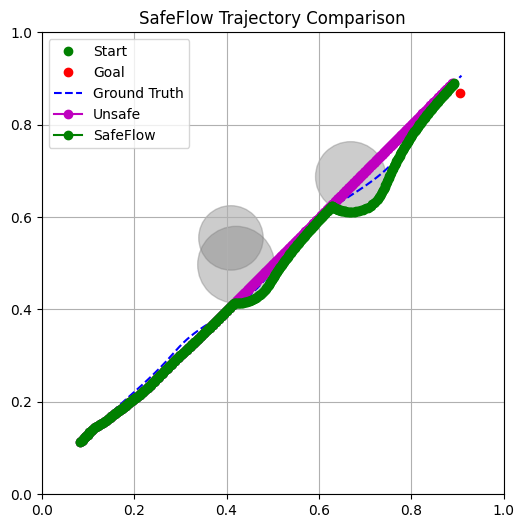

In [73]:
visualize_safe_vs_unsafe(trained_model, dataset, sample_idx=90)

